In [18]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix

In [2]:
#load in dataset
df = pd.read_csv('Downloads/high_diamond_ranked_10min.csv')
df.head()

,gameId,blueWins,blueWardsPlaced,blueWardsDestroyed,blueFirstBlood,blueKills,blueDeaths,blueAssists,blueEliteMonsters,blueDragons,...,redTowersDestroyed,redTotalGold,redAvgLevel,redTotalExperience,redTotalMinionsKilled,redTotalJungleMinionsKilled,redGoldDiff,redExperienceDiff,redCSPerMin,redGoldPerMin
0,4519157822,0,28,2,1,9,6,11,0,0,...,0,16567,6.8,17047,197,55,-643,8,19.7,1656.7
1,4523371949,0,12,1,0,5,5,5,0,0,...,1,17620,6.8,17438,240,52,2908,1173,24.0,1762.0
2,4521474530,0,15,0,0,7,11,4,1,1,...,0,17285,6.8,17254,203,28,1172,1033,20.3,1728.5
3,4524384067,0,43,1,0,4,5,5,1,0,...,0,16478,7.0,17961,235,47,1321,7,23.5,1647.8
4,4436033771,0,75,4,0,6,6,6,0,0,...,0,17404,7.0,18313,225,67,1004,-230,22.5,1740.4


In [3]:
X = df.iloc[:,2:-1]
y = df.blueWins

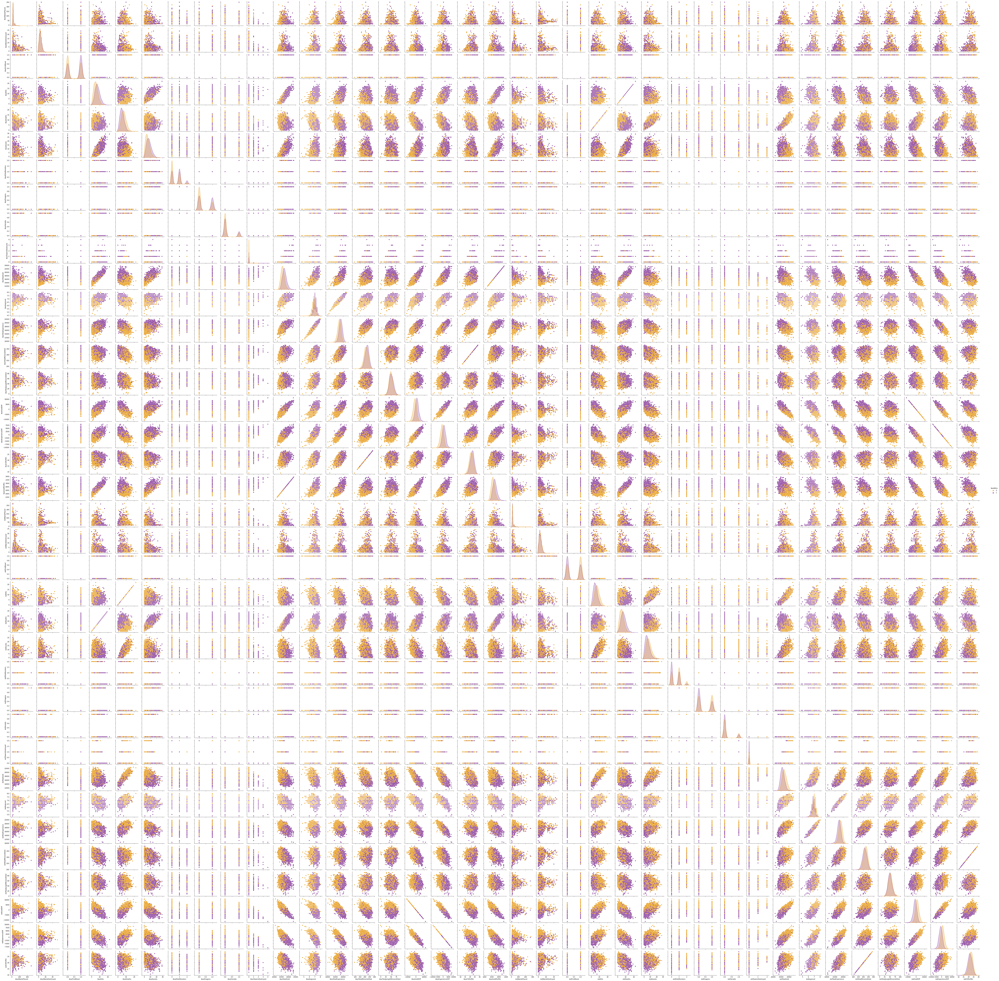

In [4]:
#Split the data into train and test sets (80/20) 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = .2, random_state=8)

In [5]:
#we will take the mean of the target variable as the baseline probability, should be around 50%
print("baseline prob = ", np.mean(y_train))

baseline prob =  0.4953815006959382


In [6]:
#scale data for knn and logreg
std_scale = StandardScaler()

X_train_scaled = std_scale.fit_transform(X_train)
X_test_scaled = std_scale.transform(X_test)

We want to prioritize less false positives, as this modelling will be used to inform betting on esports,
and more false positives would lead to more unsuccessful betting

Another thing to think about is what kind of model would be better to explain to esports betters.
kNN and logistic regression would be easier to explain, but models may be too simple. The logreg coefs would be 
especially helpful

# kNN

In [35]:
knn = KNeighborsClassifier(n_neighbors=7)
knn.fit(X_train_scaled, y_train)
y_pred_knn = knn.predict(X_test_scaled)

print("Model: kNN\n")
#we will only concern ourselves with accuracy, since its a simple data set where accuracy will suffice
print("Test set accuracy:", knn.score(X_test_scaled, y_test))
print("Train set accuracy:", knn.score(X_train_scaled, y_train))  
print("accuracy score:", (accuracy_score(y_test, y_pred_knn))) 

Model: kNN

Test set accuracy: 0.6862348178137652
Train set accuracy: 0.7699607743894723
accuracy score: 0.6862348178137652


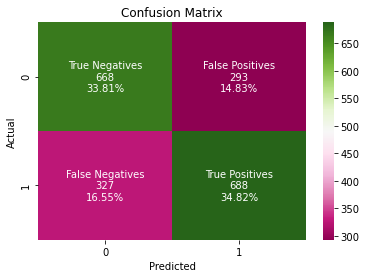

In [36]:
cm = confusion_matrix(y_test, y_pred_knn)

names = ["True Negatives","False Positives","False Negatives","True Positives"]
counts = ["{0:0.0f}".format(value) for value in cm.flatten()]
percents = ["{0:.2%}".format(value) for value in cm.flatten()/np.sum(cm)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in zip(names,counts,percents)]
labels = np.asarray(labels).reshape(2,2)

sns.heatmap(cm, annot=labels, fmt="", cmap="PiYG");
plt.title("Confusion Matrix")
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.show()

# LogReg

In [7]:
#instantiate, then fit
logreg = LogisticRegression()
logreg.fit(X_train_scaled, y_train)

#prediction
p_pred = logreg.predict_proba(X_test_scaled)[:,1]
y_pred = np.where(p_pred > 0.5, 1, 0)
print(y_pred)

[1 0 1 ... 0 0 0]


In [34]:
print("Model: LogReg\n")
#we will only concern ourselves with accuracy, since its a simple data set where accuracy will suffice
print("Test set accuracy:", logreg.score(X_test_scaled, y_test))
print("Train set accuracy:", logreg.score(X_train_scaled, y_train))  
print("accuracy score:", (accuracy_score(y_test, y_pred))) 

Model: LogReg

Test set accuracy: 0.7211538461538461
Train set accuracy: 0.736429204099709
accuracy score: 0.7211538461538461


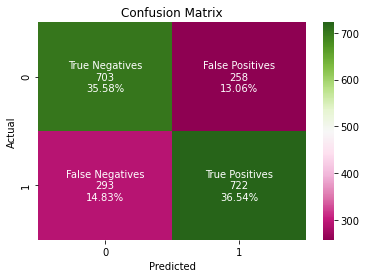

In [9]:
cm = confusion_matrix(y_test, y_pred)

names = ["True Negatives","False Positives","False Negatives","True Positives"]
counts = ["{0:0.0f}".format(value) for value in cm.flatten()]
percents = ["{0:.2%}".format(value) for value in cm.flatten()/np.sum(cm)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in zip(names,counts,percents)]
labels = np.asarray(labels).reshape(2,2)

sns.heatmap(cm, annot=labels, fmt="", cmap="PiYG");
plt.title("Confusion Matrix")
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.show()

In [10]:
col_to_drop = []
i=0
while i < len(list(X.columns.values)):
    #|col|<0.015?
    if np.abs(logreg.coef_[0][i]) <= 0.015:
        get_rid = True
        col_to_drop.append(X.columns.values[i])
    else:
        get_rid = False
    print(get_rid,X.columns.values[i], ":", logreg.coef_[0][i])
    i+=1

False blueWardsPlaced : -0.031817633791235894
True blueWardsDestroyed : -0.010394724592536297
False blueFirstBlood : 0.022914961685078932
False blueKills : -0.025722195857620315
False blueDeaths : 0.051633606760776454
False blueAssists : -0.032792590028392896
False blueEliteMonsters : 0.07560560670319226
False blueDragons : 0.12030023239031903
False blueHeralds : -0.02655987367439851
False blueTowersDestroyed : -0.050760664042526896
False blueTotalGold : 0.15762963175432834
False blueAvgLevel : -0.020734449950944315
False blueTotalExperience : 0.13940998417730946
False blueTotalMinionsKilled : -0.030375957525634698
False blueTotalJungleMinionsKilled : 0.040334378886144516
False blueGoldDiff : 0.31152362436018843
False blueExperienceDiff : 0.1620616648497525
False blueCSPerMin : -0.030375957525635686
False blueGoldPerMin : 0.15762963175432795
False redWardsPlaced : -0.0339167021866691
True redWardsDestroyed : 0.006086424168443384
False redFirstBlood : -0.022914961685078932
False redKill

In [11]:
#try dropping |col|<0.05
X = X.drop(col_to_drop,axis='columns')

In [12]:
#Split the data into train and test sets (80/20) 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = .2, random_state=8)

In [13]:
#scale data for logreg
std_scale = StandardScaler()

X_train_scaled = std_scale.fit_transform(X_train)
X_test_scaled = std_scale.transform(X_test)

In [14]:
#instantiate, then fit
logreg = LogisticRegression()
logreg.fit(X_train_scaled, y_train)

#prediction
p_pred = logreg.predict_proba(X_test_scaled)[:,1]
y_pred = np.where(p_pred > 0.5, 1, 0)
print(y_pred)

[1 0 1 ... 0 0 0]


In [15]:
print("Baseline Model: LogReg\n")

print("Test set accuracy:", logreg.score(X_test_scaled, y_test))
print("Train set accuracy:", logreg.score(X_train_scaled, y_train))  
print("accuracy score:", (accuracy_score(y_test, y_pred))) 

Baseline Model: LogReg

Test set accuracy: 0.7211538461538461
Train set accuracy: 0.736429204099709
accuracy score: 0.7211538461538461


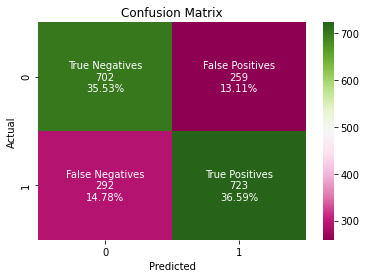

In [16]:
cm = confusion_matrix(y_test, y_pred)

names = ["True Negatives","False Positives","False Negatives","True Positives"]
counts = ["{0:0.0f}".format(value) for value in cm.flatten()]
percents = ["{0:.2%}".format(value) for value in cm.flatten()/np.sum(cm)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in zip(names,counts,percents)]
labels = np.asarray(labels).reshape(2,2)

sns.heatmap(cm, annot=labels, fmt="", cmap="PiYG");
plt.title("Confusion Matrix")
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.show()

#true negatives worsen, true positives better